# Transfer learning with pretrained Keras models

Although Kernel resources were increased recently we still can not train useful CNNs without GPU. The original ImageNet set has quite a few different dog classes so we can reuse CNNs with pretrained ImageNet weights. Fortunately prediction is much faster (<1s/image) making it possible to run meaningful experiments with Kaggle Kernels.

In [5]:
%matplotlib inline
import tensorflow as tf


import numpy as np
import pandas as pd

import datetime as dt
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from os import listdir, makedirs
from os.path import join, exists, expanduser
from tqdm import tqdm
from sklearn.metrics import log_loss, accuracy_score
from keras.preprocessing import image
from keras.applications.vgg16 import VGG16
from keras.applications.resnet50 import ResNet50
from keras.applications import xception
from keras.applications import inception_v3
from keras.applications.vgg16 import preprocess_input, decode_predictions
from sklearn.linear_model import LogisticRegression

C:\Users\Java\Anaconda3\lib\site-packages\h5py\__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
start = dt.datetime.now()
start

datetime.datetime(2018, 3, 13, 15, 39, 47, 354769)

# Use Keras Pretrained Models dataset

Kernels can't use network connection to download pretrained keras model weights.
This dataset helps you to apply your favorite pretrained model in the Kaggle Kernel environment. 
You can find more details [here](https://www.kaggle.com/gaborfodor/keras-pretrained-models).

We have to copy the pretrained models to the cache directory (~/.keras/models) where keras is looking for them.


In [3]:
!dir C:\Users\Java\tensorflow\testdog\input\keras-pretrained-models

 磁碟區 C 中的磁碟沒有標籤。
 磁碟區序號:  B2EA-A033

 C:\Users\Java\tensorflow\testdog\input\keras-pretrained-models 的目錄

2018/02/07  下午 07:43    <DIR>          .
2018/02/07  下午 07:43    <DIR>          ..
2018/02/07  下午 07:14            35,363 imagenet_class_index.json
2018/02/07  下午 07:17       208,457,807 inception_resnet_v2_weights_tf_dim_ordering_tf_kernels.h5.zip
2018/02/07  下午 07:17       202,761,787 inception_resnet_v2_weights_tf_dim_ordering_tf_kernels_notop.h5.zip
2018/02/07  下午 07:16        88,656,888 inception_v3_weights_tf_dim_ordering_tf_kernels.h5.zip
2018/02/07  下午 07:16        81,051,582 inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5.zip
2018/02/07  下午 07:16         8,430,416 Kuszma.JPG.zip
2018/02/07  下午 07:17        95,169,146 resnet50_weights_tf_dim_ordering_tf_kernels.h5.zip
2018/02/07  下午 07:17        87,543,439 resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5.zip
2018/02/07  下午 07:16        54,732,517 vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5.zip
2018/02/07 

In [4]:
cache_dir = expanduser(join('~', '.keras'))
if not exists(cache_dir):
    makedirs(cache_dir)
models_dir = join(cache_dir, 'models')
if not exists(models_dir):
    makedirs(models_dir)

In [5]:
!COPY .\input\keras-pretrained-models\*notop* C:\Users\Java\.keras\models\
!COPY .\input\keras-pretrained-models\imagenet_class_index.json C:\Users\Java.keras\models\
!COPY .\input\keras-pretrained-models\resnet50* C:\Users\Java\.keras\models\

命令語法不正確。


In [6]:
!dir C:\Users\Java\.keras\models

 磁碟區 C 中的磁碟沒有標籤。
 磁碟區序號:  B2EA-A033

 C:\Users\Java\.keras\models 的目錄

2018/02/10  下午 08:56    <DIR>          .
2018/02/10  下午 08:56    <DIR>          ..
2018/02/07  下午 07:14            35,363 imagenet_class_index.json
2017/11/16  下午 09:20       219,055,592 inception_resnet_v2_weights_tf_dim_ordering_tf_kernels_notop.h5
2017/10/05  下午 06:35        87,910,968 inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
2017/10/04  上午 02:55       102,853,048 resnet50_weights_tf_dim_ordering_tf_kernels.h5
2017/10/04  上午 02:55        94,653,016 resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5
2017/10/04  上午 01:04        58,889,256 vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5
2017/10/04  上午 03:09        83,683,744 xception_weights_tf_dim_ordering_tf_kernels_notop.h5
               7 個檔案     647,080,987 位元組
               2 個目錄  296,111,775,744 位元組可用


In [7]:
!dir .\input\dog-breed-identification

 磁碟區 C 中的磁碟沒有標籤。
 磁碟區序號:  B2EA-A033

 C:\Users\Java\tensorflow\testdog\input\dog-breed-identification 的目錄

2018/02/07  下午 08:39    <DIR>          .
2018/02/07  下午 08:39    <DIR>          ..
2017/09/28  下午 03:38           482,063 labels.csv
2017/09/28  下午 03:38        25,200,295 sample_submission.csv
2018/02/07  下午 08:37    <DIR>          test
2018/02/07  下午 08:37    <DIR>          train
               2 個檔案      25,682,358 位元組
               4 個目錄  296,111,775,744 位元組可用


# Use top 16 classes
Using all the images would take more than the 1 hour kernel limit. Let's focus on the most frequent 16 breeds.

In [18]:
INPUT_SIZE = 224
NUM_CLASSES = 16
SEED = 1987
data_dir = '.\input\dog-breed-identification'
labels = pd.read_csv(join(data_dir, 'labels.csv'))
sample_submission = pd.read_csv(join(data_dir, 'sample_submission.csv'))
print(len(listdir(join(data_dir, 'train'))), len(labels))
print(len(listdir(join(data_dir, 'test'))), len(sample_submission))

10222 10222
10357 10357


In [19]:
selected_breed_list = list(labels.groupby('breed').count().sort_values(by='id', ascending=False).head(NUM_CLASSES).index)
labels = labels[labels['breed'].isin(selected_breed_list)]
labels['target'] = 1
labels['rank'] = labels.groupby('breed').rank()['id']
labels_pivot = labels.pivot('id', 'breed', 'target').reset_index().fillna(0)
np.random.seed(seed=SEED)
rnd = np.random.random(len(labels))
train_idx = rnd < 0.8
valid_idx = rnd >= 0.8
y_train = labels_pivot[selected_breed_list].values
ytr = y_train[train_idx]
yv = y_train[valid_idx]

In [11]:
def read_img(img_id, train_or_test, size):
    """Read and resize image.
    # Arguments
        img_id: string
        train_or_test: string 'train' or 'test'.
        size: resize the original image.
    # Returns
        Image as numpy array.
    """
    img = image.load_img(join(data_dir, train_or_test, '%s.jpg' % img_id), target_size=size)
    img = image.img_to_array(img)
    return img

# ResNet50 class predictions for example images

In [12]:
!pip install h5py
import h5py

You are using pip version 9.0.1, however version 9.0.2 is available.
You should consider upgrading via the 'python -m pip install --upgrade pip' command.


In [12]:
start1 = dt.datetime.now()
start1

datetime.datetime(2018, 3, 13, 15, 39, 53, 325261)

In [38]:
plt.figure(1,figsize=(16, 16))
plt.show()
np.ceil(1. * 120 / a)
print(plt.show())
list(enumerate(labels.loc[labels['rank'] == 1, ['id', 'breed']].values))

None


[(0, array(['003df8b8a8b05244b1d920bb6cf451f9', 'basenji'], dtype=object)),
 (1, array(['0042188c895a2f14ef64a918ed9c7b64', 'scottish_deerhound'],
        dtype=object)),
 (2, array(['00693b8bc2470375cc744a6391d397ec', 'maltese_dog'], dtype=object)),
 (3, array(['00bee065dcec471f26394855c5c2f3de', 'cairn'], dtype=object)),
 (4, array(['013f8fdf6d638c7bb042f5f17e8a9fdc', 'tibetan_terrier'],
        dtype=object)),
 (5, array(['0162b3e0144fb1d1ab82fbff3ace9938', 'shih-tzu'], dtype=object)),
 (6, array(['01b36cb1b80ab8c3a7d2b7128ad21bdc', 'samoyed'], dtype=object)),
 (7, array(['01ee3c7ff9bcaba9874183135877670e', 'entlebucher'], dtype=object)),
 (8, array(['0267c5f1acbab52ae4a7927e0398612b', 'airedale'], dtype=object)),
 (9, array(['0287b3374c33346e2b41f73af3a36261', 'leonberg'], dtype=object)),
 (10, array(['02d54f0dfb40038765e838459ae8c956', 'bernese_mountain_dog'],
        dtype=object)),
 (11,
  array(['0379145880ad3978f9b80f0dc2c03fba', 'afghan_hound'], dtype=object)),
 (12,
  array(

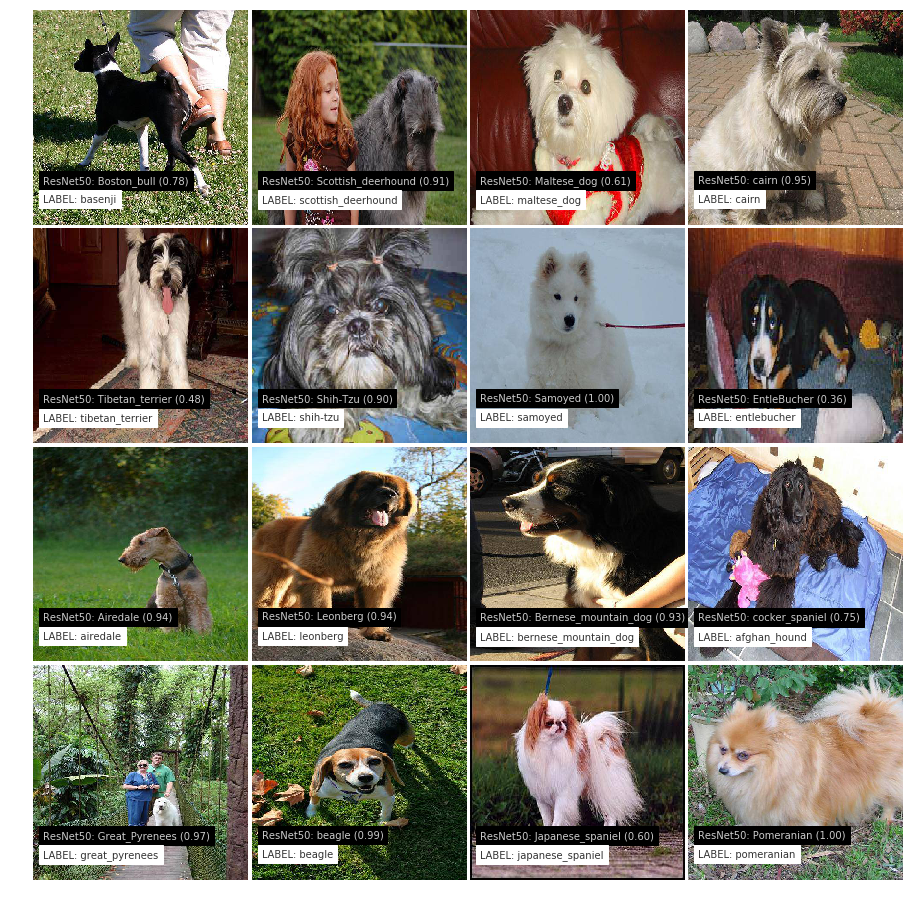

In [35]:
model = ResNet50(weights='imagenet')
j = int(np.sqrt(NUM_CLASSES)) #平方, NUM_CLASSES = 16 j = 4
i = int(np.ceil(1. * NUM_CLASSES / j)) #無條件進位  i = 4.0
fig = plt.figure(1, figsize=(16, 16)) # 圖表的大小
grid = ImageGrid(fig, 111, nrows_ncols=(i, j), axes_pad=0.05) #欄和列 = (4,4) 間隔 = 0.05
for i, (img_id, breed) in enumerate(labels.loc[labels['rank'] == 1, ['id', 'breed']].values):
    ax = grid[i]
    img = read_img(img_id, 'train', (224, 224))
    ax.imshow(img / 255.)
    x = preprocess_input(np.expand_dims(img.copy(), axis=0))
    preds = model.predict(x)
    _, imagenet_class_name, prob = decode_predictions(preds, top=1)[0][0]
    ax.text(10, 180, 'ResNet50: %s (%.2f)' % (imagenet_class_name , prob), color='w', backgroundcolor='k', alpha=0.8)
    ax.text(10, 200, 'LABEL: %s' % breed, color='k', backgroundcolor='w', alpha=0.8)
    ax.axis('off')
plt.show()

In [14]:
end1 = dt.datetime.now()
print('Total time {} s.'.format((end1 - start1).seconds))

Total time 28 s.


Preprocessing and prediction seems to be working. 75% accuracy on these 16 images.

# Extract VGG16 bottleneck features

In [15]:
start2 = dt.datetime.now()
start2

datetime.datetime(2018, 3, 13, 15, 43, 17, 189271)

In [16]:
INPUT_SIZE = 120
POOLING = 'avg'
x_train = np.zeros((len(labels), INPUT_SIZE, INPUT_SIZE, 3), dtype='float32')
for i, img_id in tqdm(enumerate(labels['id'])):
    img = read_img(img_id, 'train', (INPUT_SIZE, INPUT_SIZE))
    x = preprocess_input(np.expand_dims(img.copy(), axis=0))
    x_train[i] = x
print('Train Images shape: {} size: {:,}'.format(x_train.shape, x_train.size))

10222it [01:40, 101.38it/s]


Train Images shape: (10222, 120, 120, 3) size: 441,590,400


In [17]:
Xtr = x_train[train_idx]
Xv = x_train[valid_idx]
print((Xtr.shape, Xv.shape, ytr.shape, yv.shape))
vgg_bottleneck = VGG16(weights='imagenet', include_top=False, pooling=POOLING)
train_vgg_bf = vgg_bottleneck.predict(Xtr, batch_size=32, verbose=1)
valid_vgg_bf = vgg_bottleneck.predict(Xv, batch_size=32, verbose=1)
print('VGG train bottleneck features shape: {} size: {:,}'.format(train_vgg_bf.shape, train_vgg_bf.size))
print('VGG valid bottleneck features shape: {} size: {:,}'.format(valid_vgg_bf.shape, valid_vgg_bf.size))

((8140, 120, 120, 3), (2082, 120, 120, 3), (8140, 120), (2082, 120))
2082/2082 [==============================] - ETA: 31 - ETA: 30 - ETA: 30 - ETA: 29 - ETA: 29 - ETA: 28 - ETA: 28 - ETA: 27 - ETA: 27 - ETA: 26 - ETA: 26 - ETA: 26 - ETA: 25 - ETA: 25 - ETA: 24 - ETA: 24 - ETA: 23 - ETA: 23 - ETA: 22 - ETA: 22 - ETA: 21 - ETA: 21 - ETA: 20 - ETA: 20 - ETA: 19 - ETA: 19 - ETA: 18 - ETA: 18 - ETA: 17 - ETA: 17 - ETA: 16 - ETA: 16 - ETA: 15 - ETA: 15 - ETA: 14 - ETA: 14 - ETA: 13 - ETA: 13 - ETA: 12 - ETA: 12 - ETA: 11 - ETA: 11 - ETA: 10 - ETA: 10 - ETA: 9 - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - 32s 16ms/step
VGG train bottleneck features shape: (8140, 512) size: 4,167,680
VGG valid bottleneck features shape: (2082, 512) size: 1,065,984


In [18]:
#from keras.applications.imagenet_utils import decode_predictions
#decode_predictions(train_x_bf)

# LogReg on VGG bottleneck features

In [18]:
logreg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=SEED)
logreg.fit(train_vgg_bf, (ytr * range(NUM_CLASSES)).sum(axis=1))
valid_probs = logreg.predict_proba(valid_vgg_bf)
valid_preds = logreg.predict(valid_vgg_bf)

In [19]:
print('Validation VGG LogLoss {}'.format(log_loss(yv, valid_probs)))
print('Validation VGG Accuracy {}'.format(accuracy_score((yv * range(NUM_CLASSES)).sum(axis=1), valid_preds)))

Validation VGG LogLoss 8.897364619042607
Validation VGG Accuracy 0.43371757925072046


In [20]:
end2 = dt.datetime.now()
print('Total time {} s.'.format((end2 - start2).seconds))

Total time 276 s.


Not bad, 90% accuracy for the top 16 classes. The multiclass classification with 120 classes is more difficult so these LogLoss/Accuracy scores does not translate to LB.

# Extract Xception bottleneck features

In [21]:
start3 = dt.datetime.now()
start3

datetime.datetime(2018, 3, 13, 15, 47, 53, 377349)

In [22]:
INPUT_SIZE = 299
POOLING = 'avg'
x_train = np.zeros((len(labels), INPUT_SIZE, INPUT_SIZE, 3), dtype='float32')
for i, img_id in tqdm(enumerate(labels['id'])):
    img = read_img(img_id, 'train', (INPUT_SIZE, INPUT_SIZE))
    x = xception.preprocess_input(np.expand_dims(img.copy(), axis=0))
    x_train[i] = x
print('Train Images shape: {} size: {:,}'.format(x_train.shape, x_train.size))

10222it [00:44, 230.21it/s]


Train Images shape: (10222, 299, 299, 3) size: 2,741,571,066


In [23]:
Xtr = x_train[train_idx]
Xv = x_train[valid_idx]
print((Xtr.shape, Xv.shape, ytr.shape, yv.shape))
xception_bottleneck = xception.Xception(weights='imagenet', include_top=False, pooling=POOLING)
train_x_bf = xception_bottleneck.predict(Xtr, batch_size=4, verbose=1)
valid_x_bf = xception_bottleneck.predict(Xv, batch_size=4, verbose=1)
print('Xception train bottleneck features shape: {} size: {:,}'.format(train_x_bf.shape, train_x_bf.size))
print('Xception valid bottleneck features shape: {} size: {:,}'.format(valid_x_bf.shape, valid_x_bf.size))

((8140, 299, 299, 3), (2082, 299, 299, 3), (8140, 120), (2082, 120))
2082/2082 [==============================] - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1

# LogReg on Xception bottleneck features


In [24]:
logreg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=SEED)
logreg.fit(train_x_bf, (ytr * range(NUM_CLASSES)).sum(axis=1))
valid_probs = logreg.predict_proba(valid_x_bf)
valid_preds = logreg.predict(valid_x_bf)
print('Validation Xception LogLoss {}'.format(log_loss(yv, valid_probs)))
print('Validation Xception Accuracy {}'.format(accuracy_score((yv * range(NUM_CLASSES)).sum(axis=1), valid_preds)))

Validation Xception LogLoss 0.3542876661482588
Validation Xception Accuracy 0.8866474543707973


In [25]:
end3 = dt.datetime.now()
print('Total time {} s.'.format((end3 - start3).seconds))

Total time 696 s.


![](https://pics.me.me/such-wow-much-awesome-many-cool-bestest-thug-life-19337110.png)

Much better! 98% accuracy 0.07 LogLoss.

# Extract Inception bottleneck features

In [26]:
start4 = dt.datetime.now()
start4

datetime.datetime(2018, 3, 13, 15, 59, 30, 265905)

In [27]:
Xtr = x_train[train_idx]
Xv = x_train[valid_idx]
print((Xtr.shape, Xv.shape, ytr.shape, yv.shape))
inception_bottleneck = inception_v3.InceptionV3(weights='imagenet', include_top=False, pooling=POOLING)
train_i_bf = inception_bottleneck.predict(Xtr, batch_size=32, verbose=1)
valid_i_bf = inception_bottleneck.predict(Xv, batch_size=32, verbose=1)
print('InceptionV3 train bottleneck features shape: {} size: {:,}'.format(train_i_bf.shape, train_i_bf.size))
print('InceptionV3 valid bottleneck features shape: {} size: {:,}'.format(valid_i_bf.shape, valid_i_bf.size))

((8140, 299, 299, 3), (2082, 299, 299, 3), (8140, 120), (2082, 120))
2082/2082 [==============================] - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 59s - ETA: 58 - ETA: 57 - ETA: 56 - ETA: 54 - ETA: 53 - ETA: 52 - ETA: 51 - ETA: 50 - ETA: 48 - ETA: 47 - ETA: 46 - ETA: 45 - ETA: 44 - ETA: 42 - ETA: 41 - ETA: 40 - ETA: 39 - ETA: 37 - ETA: 36 - ETA: 35 - ETA: 34 - ETA: 33 - ETA: 31 - ETA: 30 - ETA: 29 - ETA: 28 - ETA: 26 - ETA: 25 - ETA: 24 - ETA: 23 - ETA: 22 - ETA: 20 - ETA: 19 - ETA: 18 - ETA: 17 - ETA: 15 - ETA: 14 - ETA: 13 - ETA: 12 - ETA: 11 - ETA: 9 - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - 80s 38ms/step
InceptionV3 train bottleneck features shape: (8140, 2048) size: 16,670,720
InceptionV3 valid bottleneck features shape: (2082, 2048) size: 4,263,936


# LogReg on Inception bottleneck features

In [28]:
logreg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=SEED)
logreg.fit(train_i_bf, (ytr * range(NUM_CLASSES)).sum(axis=1))
valid_probs = logreg.predict_proba(valid_i_bf)
valid_preds = logreg.predict(valid_i_bf)

In [29]:
print('Validation Inception LogLoss {}'.format(log_loss(yv, valid_probs)))
print('Validation Inception Accuracy {}'.format(accuracy_score((yv * range(NUM_CLASSES)).sum(axis=1), valid_preds)))

Validation Inception LogLoss 0.34821762700297587
Validation Inception Accuracy 0.8924111431316042


In [30]:
end4 = dt.datetime.now()
print('Total time {} s.'.format((end4 - start4).seconds))

Total time 590 s.


# LogReg on all bottleneck features

In [31]:
start5 = dt.datetime.now()
start5

datetime.datetime(2018, 3, 13, 16, 9, 20, 845385)

In [32]:
X = np.hstack([train_x_bf, train_i_bf])
V = np.hstack([valid_x_bf, valid_i_bf])
print('Full train bottleneck features shape: {} size: {:,}'.format(X.shape, X.size))
print('Full valid bottleneck features shape: {} size: {:,}'.format(V.shape, V.size))
logreg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=SEED)
logreg.fit(X, (ytr * range(NUM_CLASSES)).sum(axis=1))
valid_probs = logreg.predict_proba(V)
valid_preds = logreg.predict(V)
print('Validation Xception + Inception LogLoss {}'.format(log_loss(yv, valid_probs)))
print('Validation Xception + Inception Accuracy {}'.format(accuracy_score((yv * range(NUM_CLASSES)).sum(axis=1), valid_preds)))

Full train bottleneck features shape: (8140, 4096) size: 33,341,440
Full valid bottleneck features shape: (2082, 4096) size: 8,527,872
Validation Xception + Inception LogLoss 0.3120227727242602
Validation Xception + Inception Accuracy 0.899135446685879


In [10]:
# python scikit-learn save & load model
import pickle

# save model
#with open('AllFlog', 'wb') as file:  
#    pickle.dump(logreg, file)

# load model    
#with open('AllFlog', 'rb') as file:  
#    pickle_model = pickle.load(file)

In [34]:
a  = read_img('020ecfccf3c900b01ce831abbf20b485', 'train', (200,200))

In [35]:
end4 = dt.datetime.now()
print('Total time {} s.'.format((end4 - start4).seconds))

Total time 628 s.


Training this model on the full dataset would give 0.3 LogLoss on LB.

# Check errors
We still have a few misclassification errors.

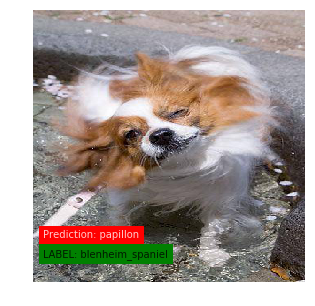

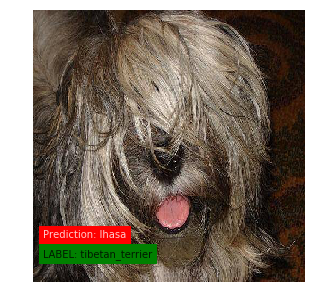

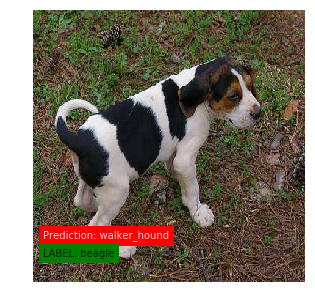

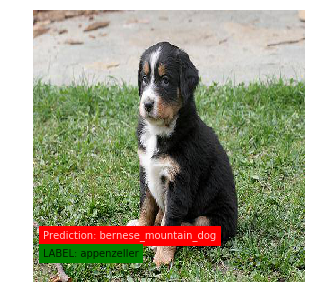

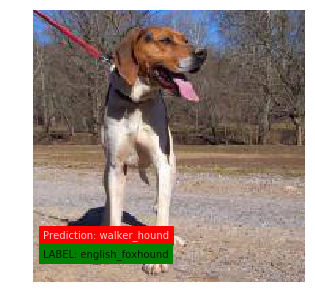

...

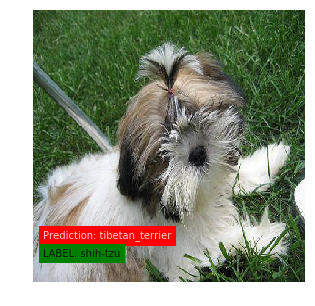

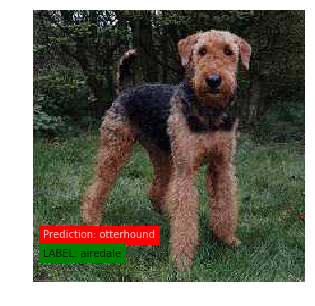

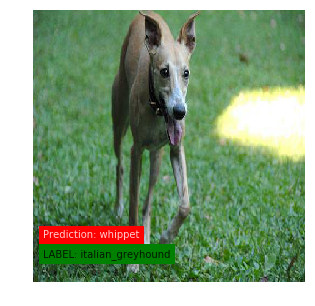

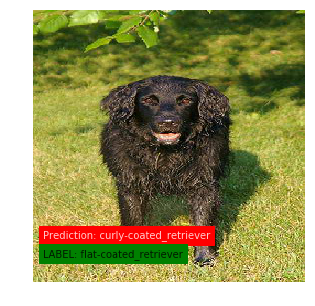

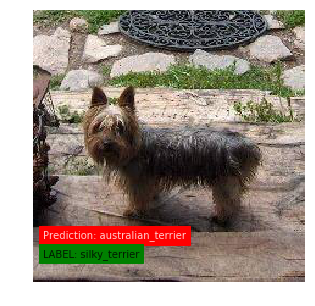

In [36]:
valid_breeds = (yv * range(NUM_CLASSES)).sum(axis=1)
error_idx = (valid_breeds != valid_preds)
for img_id, breed, pred in zip(labels.loc[valid_idx, 'id'].values[error_idx],
                                [selected_breed_list[int(b)] for b in valid_preds[error_idx]],
                                [selected_breed_list[int(b)] for b in valid_breeds[error_idx]]):
    fig, ax = plt.subplots(figsize=(5,5))
    img = read_img(img_id, 'train', (299, 299))
    ax.imshow(img / 255.)
    ax.text(10, 250, 'Prediction: %s' % pred, color='w', backgroundcolor='r', alpha=0.8)
    ax.text(10, 270, 'LABEL: %s' % breed, color='k', backgroundcolor='g', alpha=0.8)
    ax.axis('off')
    plt.show()                                                    

In [37]:
end = dt.datetime.now()
print('Total time {} s.'.format((end - start).seconds))
print('We almost used the one hour time limit.')

Total time 1842 s.
We almost used the one hour time limit.
